In [1]:
%load_ext autoreload
%autoreload 2
!hostname
!pwd
import os, sys
print(sys.executable)
os.environ['CUDA_VISIBLE_DEVICES'] = "4"
os.environ['XLA_PYTHON_CLIENT_PREALLOCATE'] = 'false'

fish-gcp005
/home/akarshkumar0101/nca-alife/src
/home/akarshkumar0101/miniconda3/envs/nca-alife-jax/bin/python


In [2]:
import os, sys, glob, pickle
from functools import partial

import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()

from tqdm.auto import tqdm
from einops import rearrange, reduce, repeat

In [3]:
import experiment_utils
import util

# Create Experiment

In [4]:
! rm -rf ./experiments
! mkdir -p ./experiments

In [ ]:
group.add_argument("--seed", type=int, default=0)
group.add_argument("--save_dir", type=str, default=None)

group = parser.add_argument_group("model")
group.add_argument("--n_particles", type=int, default=5000)
group.add_argument("--n_colors", type=int, default=6)
group.add_argument("--search_space", type=str, default="beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist")
group.add_argument("--render_radius", type=float, default=7e-3)
group.add_argument("--rollout_steps", type=int, default=1024)

group = parser.add_argument_group("data")
group.add_argument("--clip_model", type=str, default="clip-vit-base-patch32") # clip-vit-base-patch32 or clip-vit-large-patch14

group = parser.add_argument_group("optimization")
group.add_argument("--bs", type=int, default=16)
group.add_argument("--pop_size", type=int, default=512)
group.add_argument("--n_iters", type=int, default=3000)
group.add_argument("--sigma1", type=float, default=0.1)
group.add_argument("--sigma2", type=float, default=0.)

In [5]:
cfg_default = dict(
    seed=0, save_dir=None,
    n_particles=5000, n_colors=6,
    search_space="beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist",
    render_radius=7e-3,
    rollout_steps=1024,

    bs=16, pop_size=512,
    n_iters=3000,
    sigma1=0.1, sigma2=0.
)

seed_sweep = np.arange(1)

search_space_sweep = [
    "alpha",
    "beta+alpha",
    "beta+alpha+mass",
    "beta+alpha+mass+c_dist",
    "beta+alpha+mass+c_dist+x_dist",
    "beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist",
]
render_radius_sweep = [1e-2]
sigma1_sweep = [0.1, 0.5]

cfgs = []
for seed in seed_sweep:
    for search_space in search_space_sweep:
        for sigma1 in sigma1_sweep:
            for render_radius in render_radius_sweep:
                cfg = cfg_default.copy()
                cfg.update(seed=seed, search_space=search_space, sigma1=sigma1, render_radius=render_radius)
                cfg.update(save_dir=f"/home/akarshkumar0101/nca-alife-data/plife_diversity_0/{seed}_{search_space}_{sigma1:.3f}_{render_radius:.3f}")
                cfgs.append(cfg)

# print(cfgs)
print(len(cfgs))

12


In [6]:
commands = experiment_utils.create_commands(cfgs, prefix='python train_diversity_plife.py', out_file='./experiments/main.sh')
print('\n'.join(commands[:3]), '\n...')
print(len(commands), 'commands')

python train_diversity_plife.py --seed=0 --save_dir="/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_alpha_0.100_0.010"                                           --n_particles=5000 --n_colors=6 --search_space="alpha"                                           --render_radius=0.01 --rollout_steps=1024 --bs=16 --pop_size=512 --n_iters=3000 --sigma1=0.1 --sigma2=0.0
python train_diversity_plife.py --seed=0 --save_dir="/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_alpha_0.500_0.010"                                           --n_particles=5000 --n_colors=6 --search_space="alpha"                                           --render_radius=0.01 --rollout_steps=1024 --bs=16 --pop_size=512 --n_iters=3000 --sigma1=0.5 --sigma2=0.0
python train_diversity_plife.py --seed=0 --save_dir="/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha_0.100_0.010"                                      --n_particles=5000 --n_colors=6 --search_space="beta+alpha"                      

# Visualize Results

In [7]:
import jax
import jax.numpy as jnp
import copy

In [23]:
df = []
for cfg in tqdm(cfgs):
    save_dir = cfg['save_dir']
    dfi = copy.copy(cfg)
    dfi['final_loss'] = util.load_pkl(cfg['save_dir'], "data")['loss'][-50:].mean()
    df.append(dfi)
df = pd.DataFrame(df)

  0%|          | 0/12 [00:00<?, ?it/s]

In [24]:
df

,seed,save_dir,n_particles,n_colors,search_space,render_radius,rollout_steps,bs,pop_size,n_iters,sigma1,sigma2,final_loss
0,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,alpha,0.01,1024,16,512,3000,0.1,0.0,0.950542
1,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,alpha,0.01,1024,16,512,3000,0.5,0.0,0.944266
2,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha,0.01,1024,16,512,3000,0.1,0.0,0.949292
3,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha,0.01,1024,16,512,3000,0.5,0.0,0.944784
4,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass,0.01,1024,16,512,3000,0.1,0.0,0.947184
5,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass,0.01,1024,16,512,3000,0.5,0.0,0.937288
6,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass+c_dist,0.01,1024,16,512,3000,0.1,0.0,0.941957
7,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass+c_dist,0.01,1024,16,512,3000,0.5,0.0,0.923146
8,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass+c_dist+x_dist,0.01,1024,16,512,3000,0.1,0.0,0.944288
9,0,/home/akarshkumar0101/nca-alife-data/plife_div...,5000,6,beta+alpha+mass+c_dist+x_dist,0.01,1024,16,512,3000,0.5,0.0,0.910169


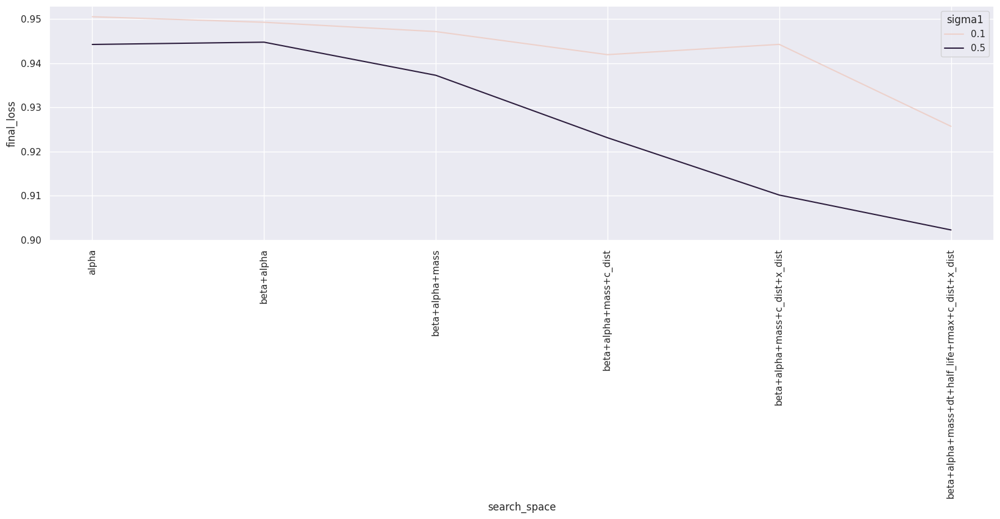

In [25]:
plt.figure(figsize=(20, 5))
sns.lineplot(data=df, x="search_space", y="final_loss", hue='sigma1')
plt.xticks(rotation=90);
plt.show()

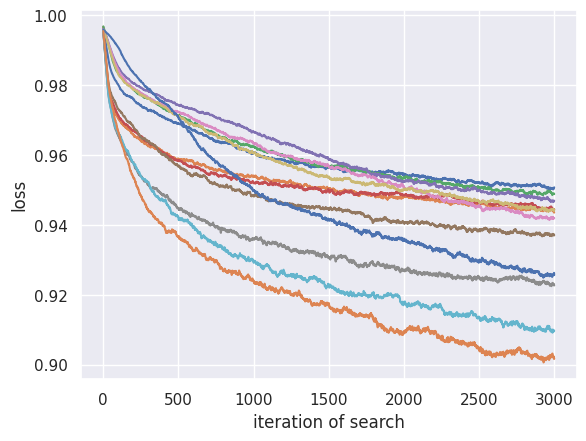

In [27]:
for cfg in cfgs:
    data = util.load_pkl(cfg['save_dir'], 'data')
    plt.plot(data['loss'])

plt.xlabel("iteration of search")
plt.ylabel("loss")
plt.show()


In [32]:
cfg = cfgs[3]
cfg

{'seed': 0,
 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha_0.500_0.010',
 'n_particles': 5000,
 'n_colors': 6,
 'search_space': 'beta+alpha',
 'render_radius': 0.01,
 'rollout_steps': 1024,
 'bs': 16,
 'pop_size': 512,
 'n_iters': 3000,
 'sigma1': 0.5,
 'sigma2': 0.0}

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_alpha_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'alpha', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


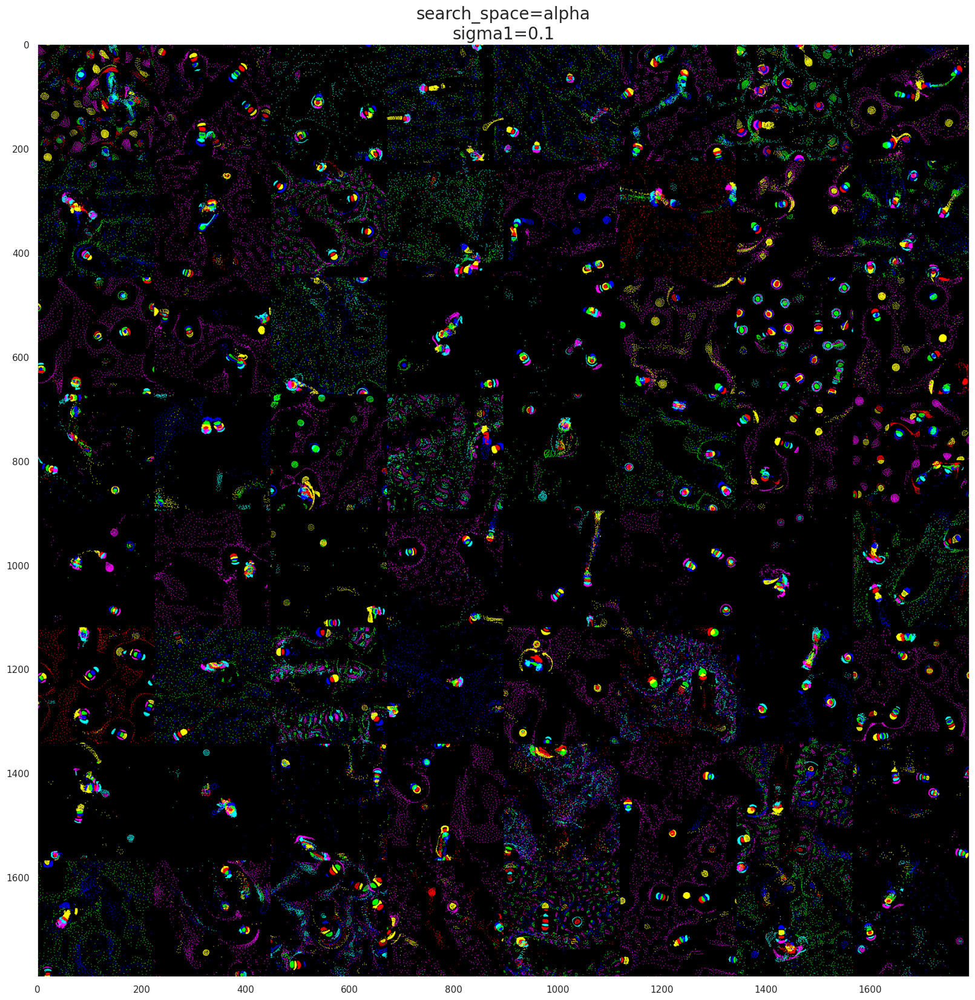

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_alpha_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'alpha', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


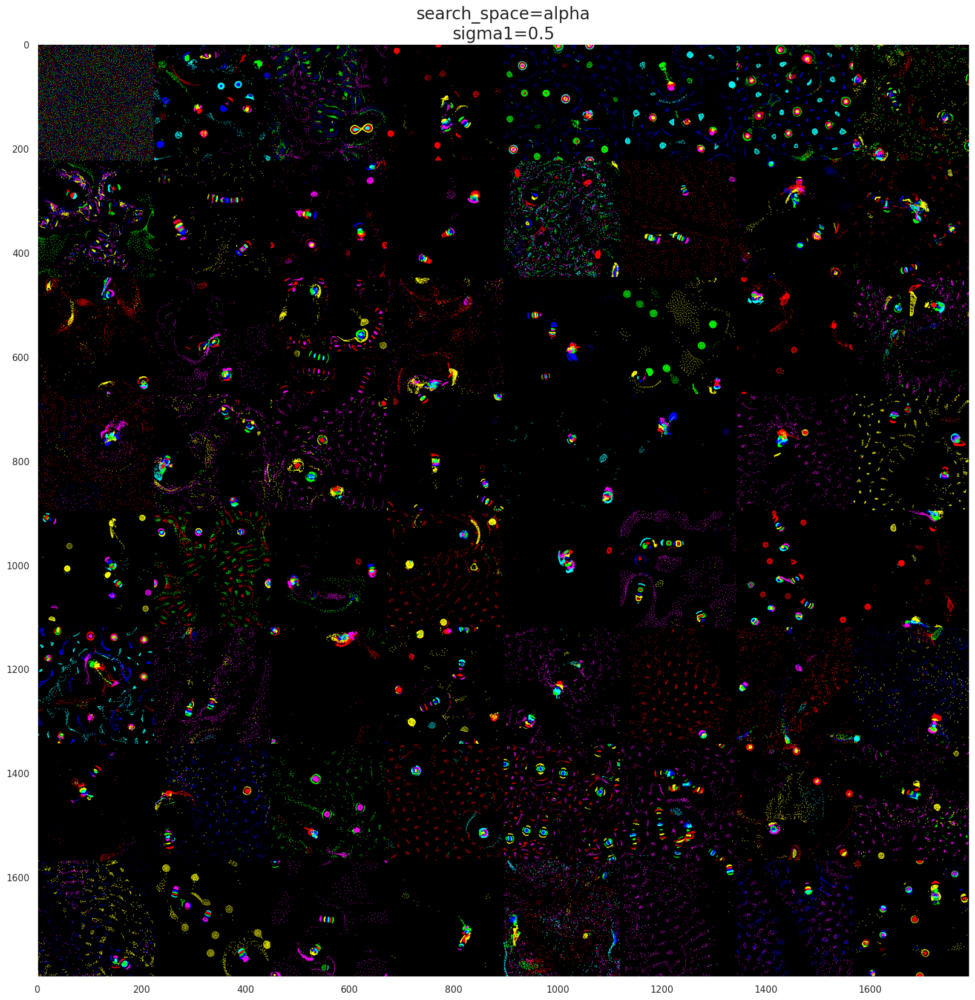

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


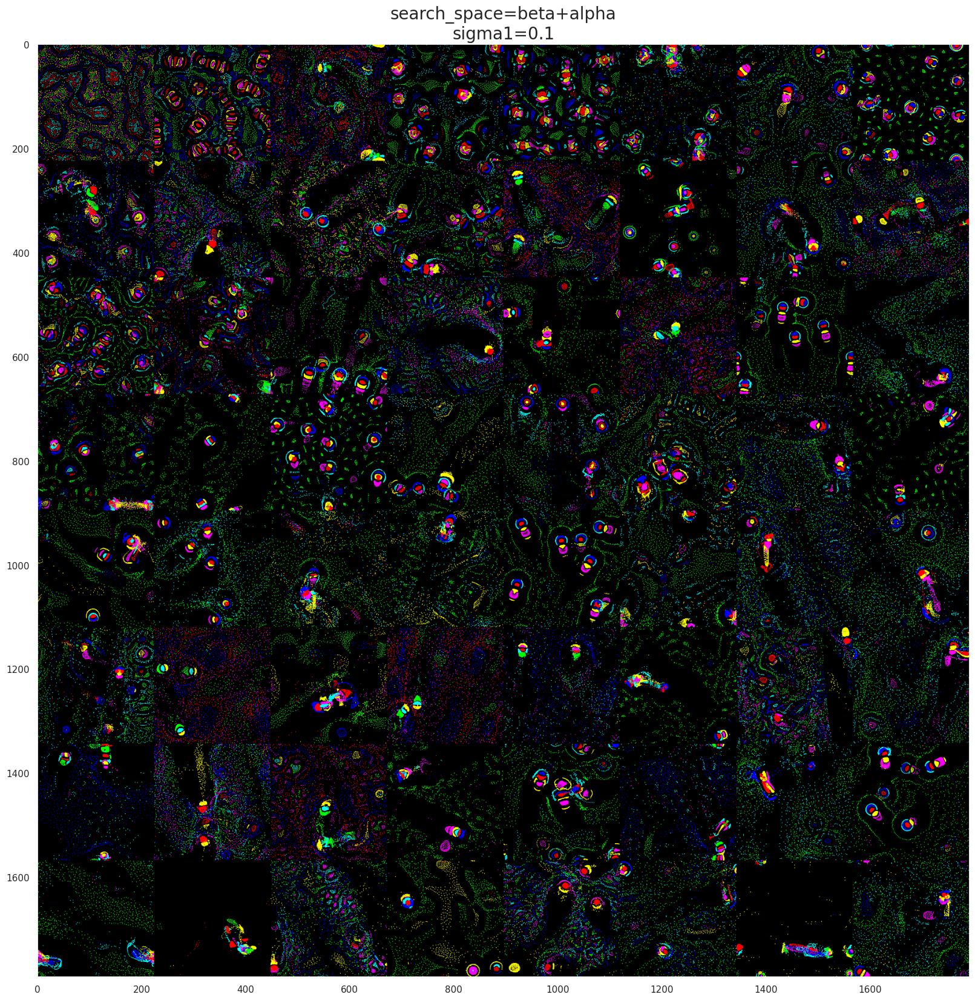

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


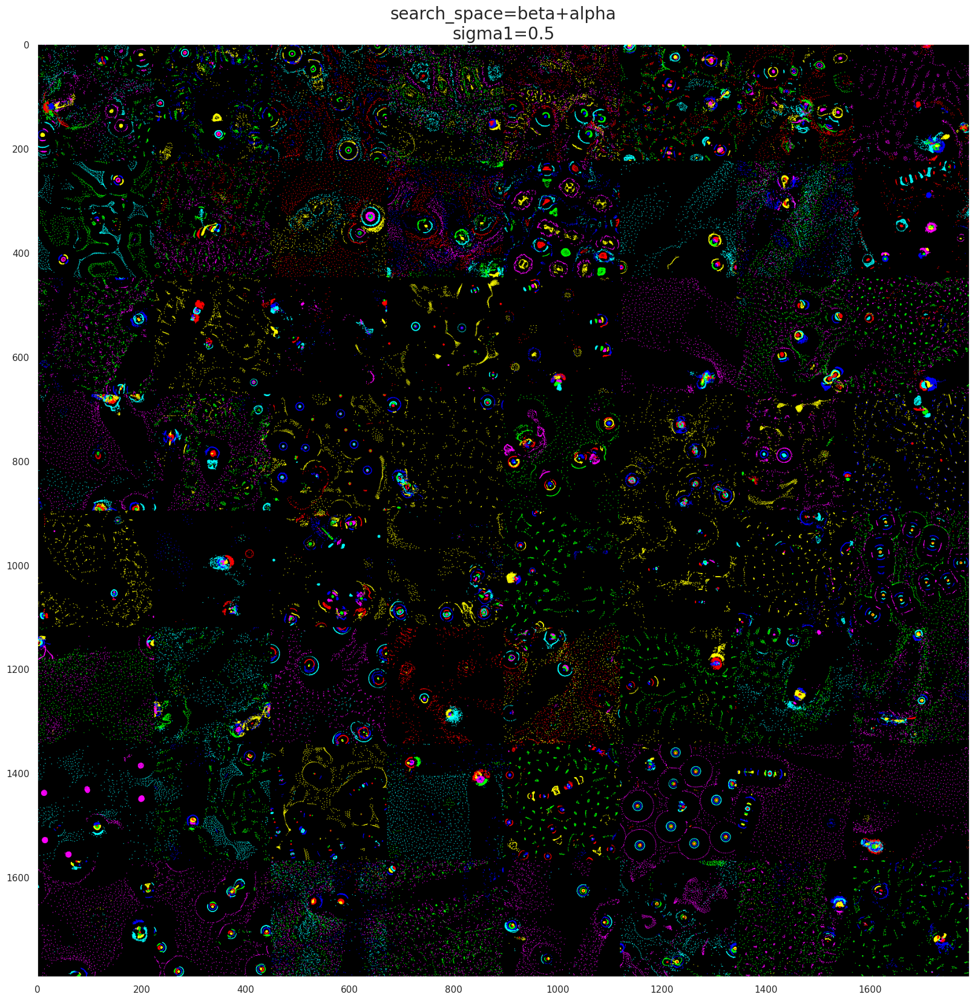

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


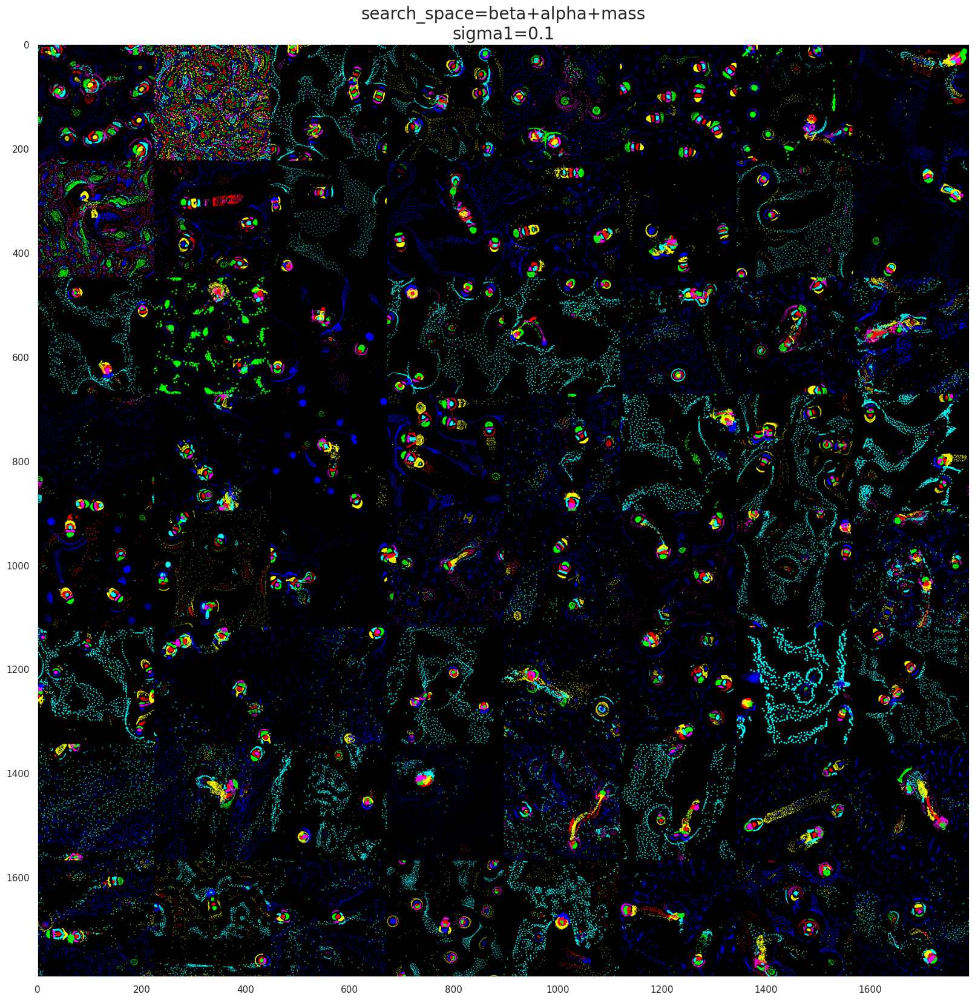

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


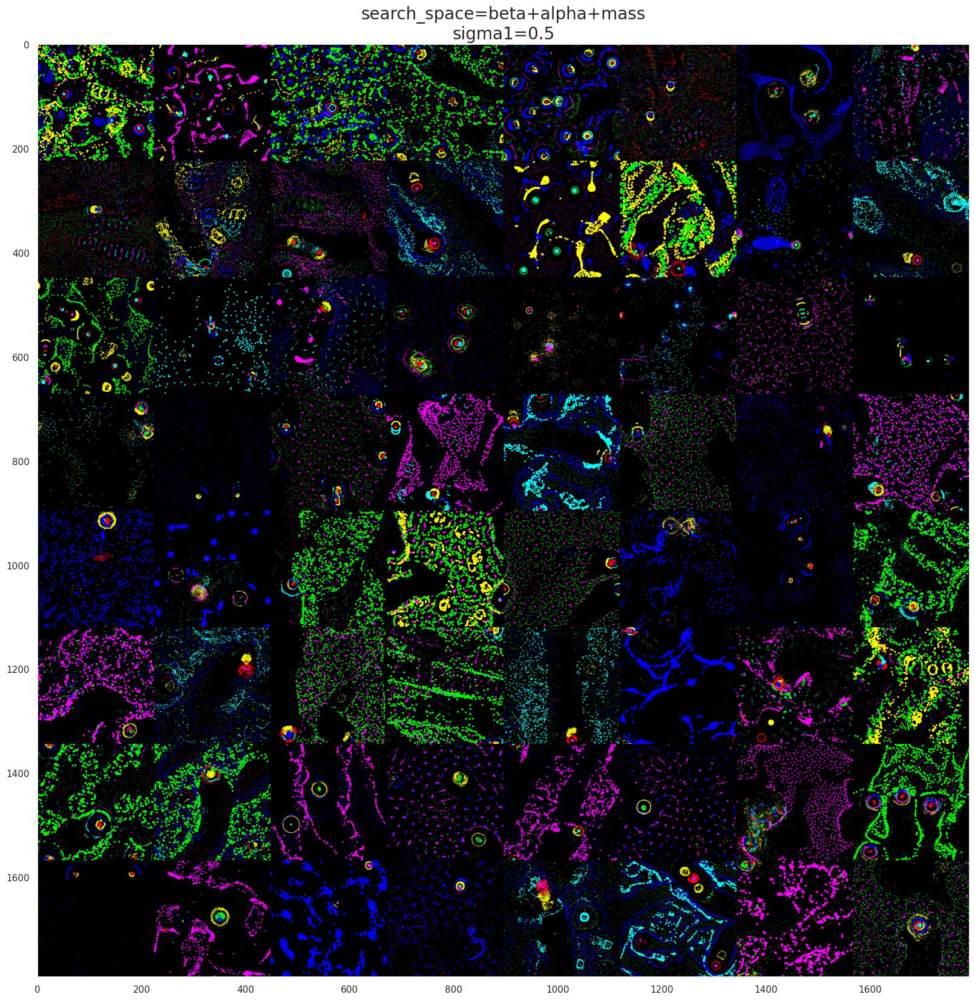

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+c_dist_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+c_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


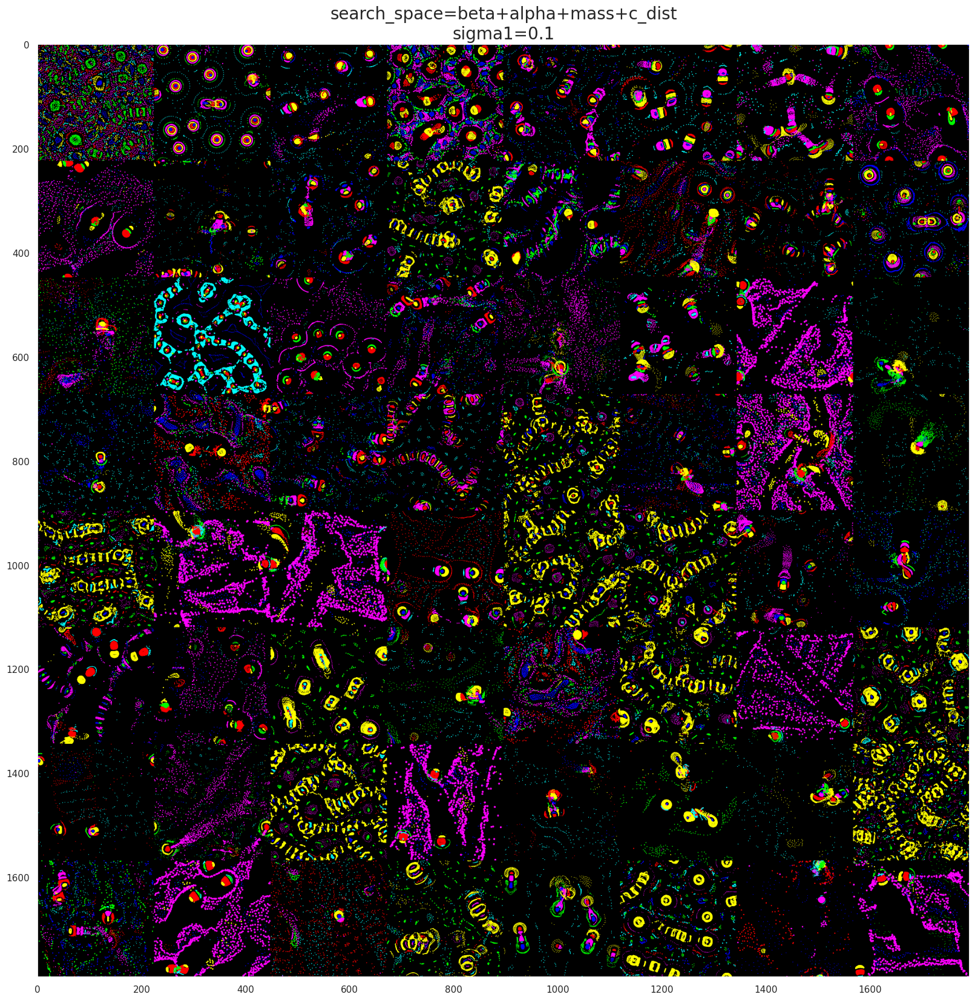

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+c_dist_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+c_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


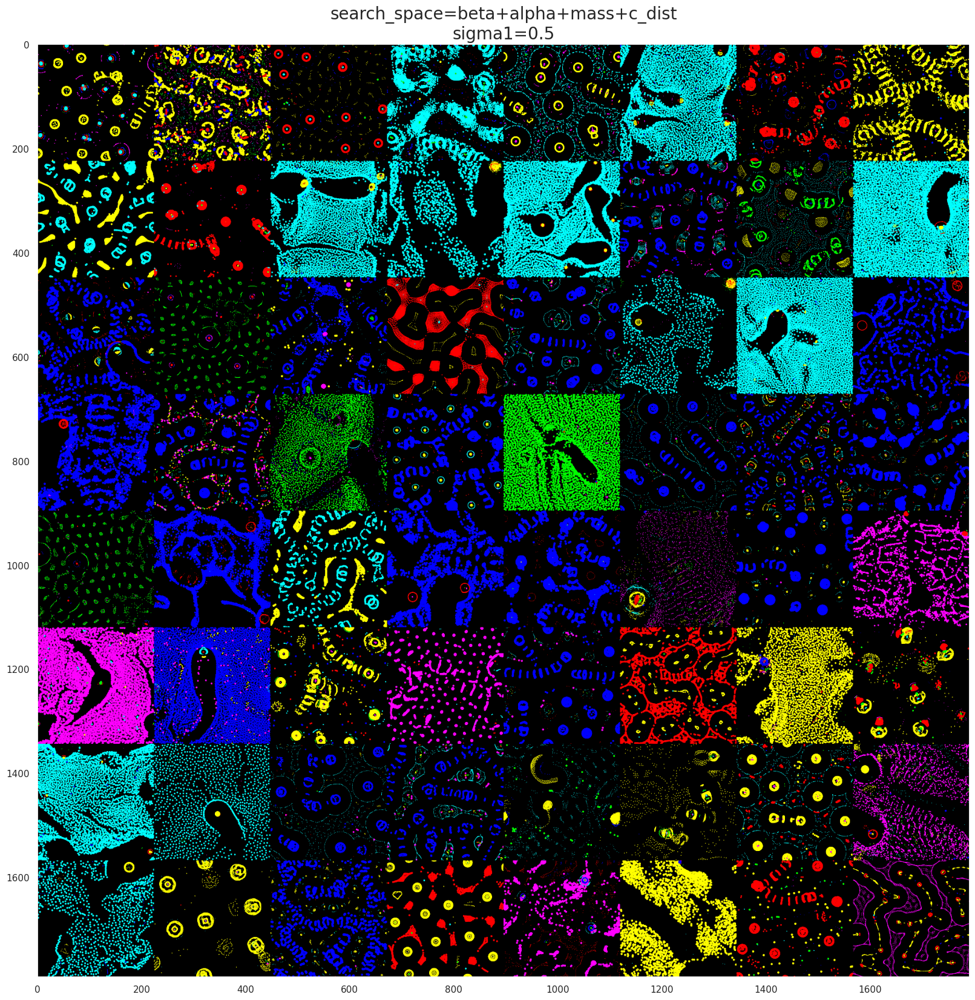

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+c_dist+x_dist_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+c_dist+x_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


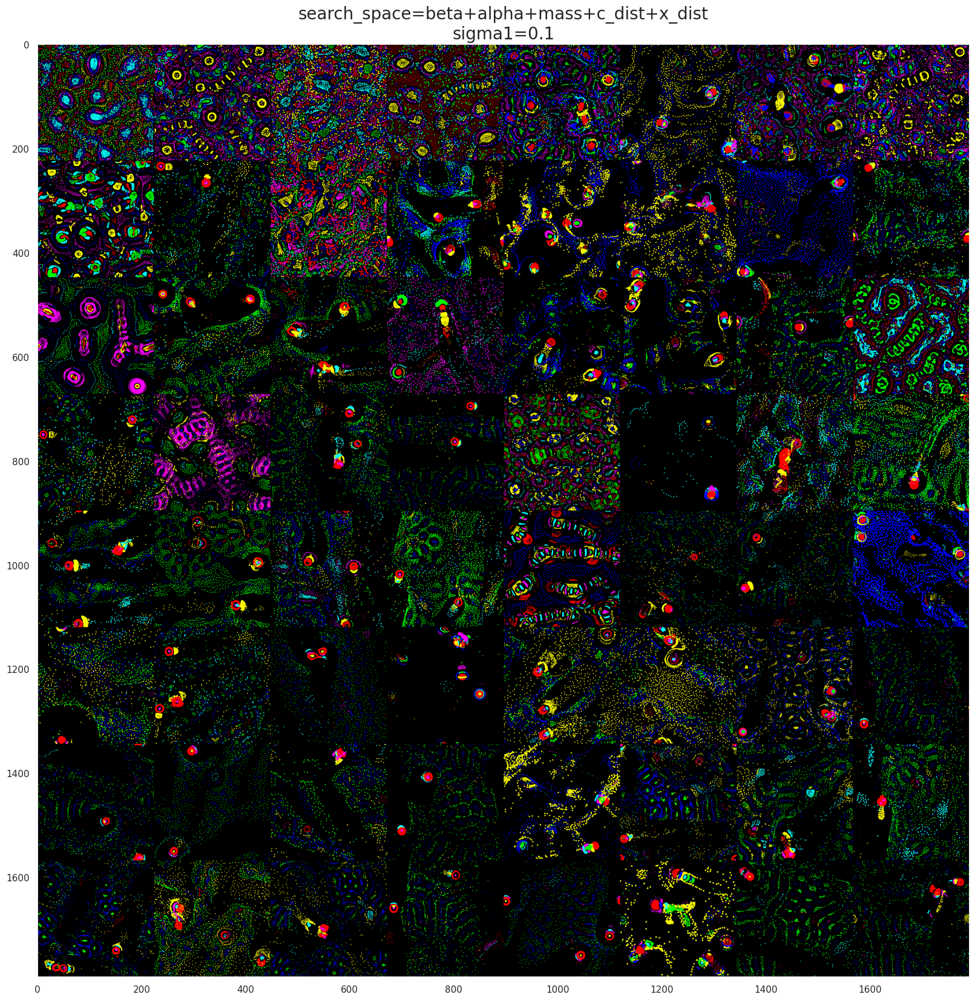

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+c_dist+x_dist_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+c_dist+x_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


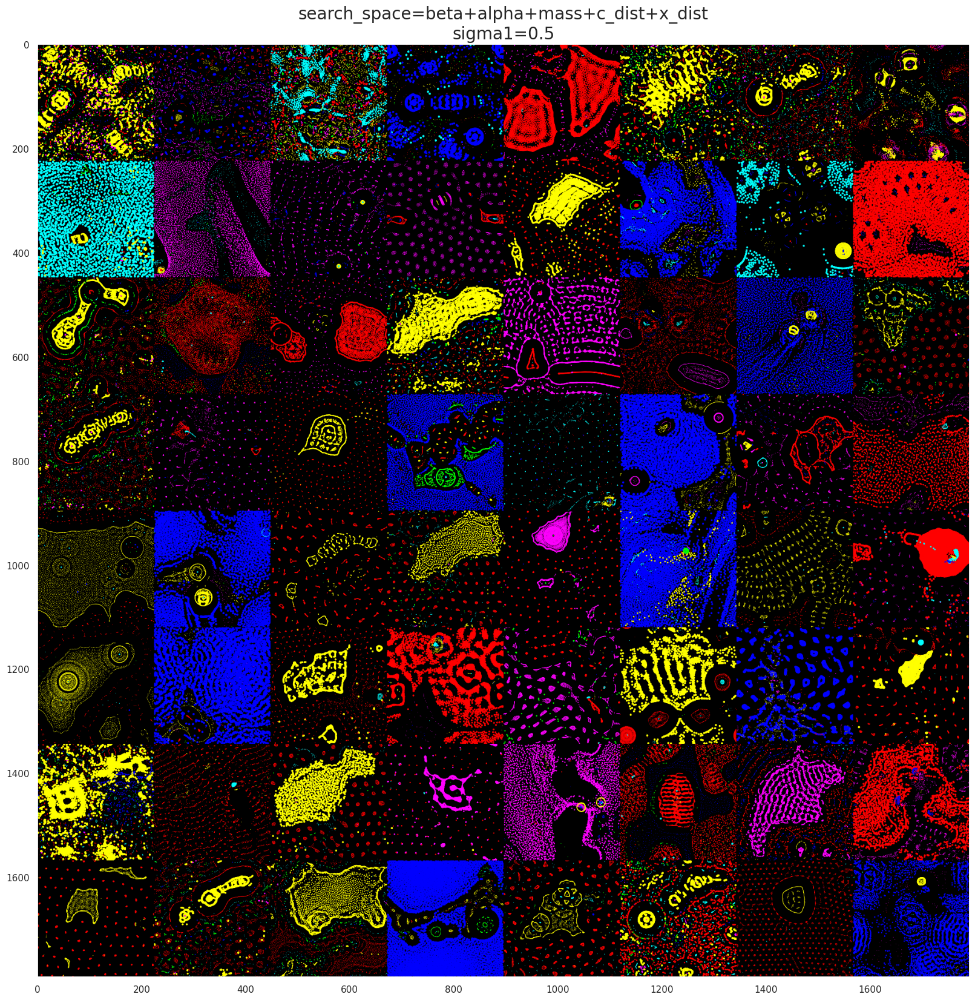

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist_0.100_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.1, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


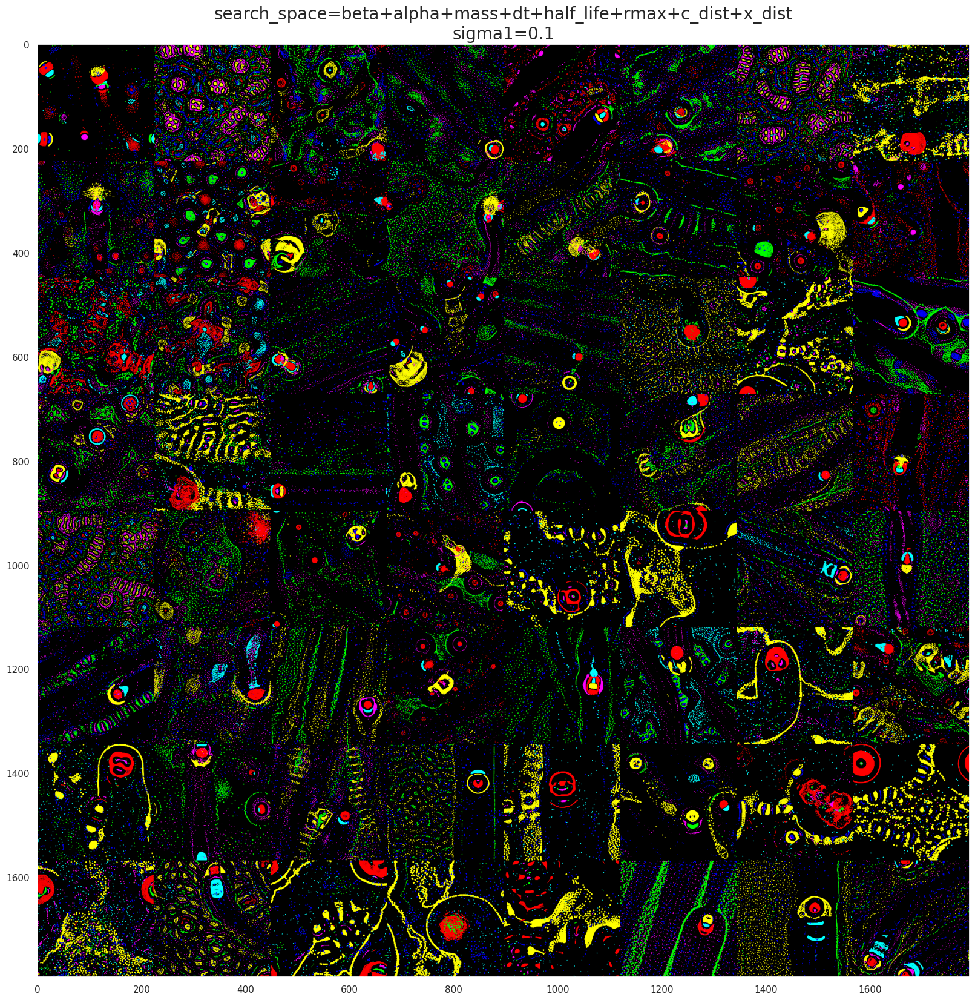

{'seed': 0, 'save_dir': '/home/akarshkumar0101/nca-alife-data/plife_diversity_0/0_beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist_0.500_0.010', 'n_particles': 5000, 'n_colors': 6, 'search_space': 'beta+alpha+mass+dt+half_life+rmax+c_dist+x_dist', 'render_radius': 0.01, 'rollout_steps': 1024, 'bs': 16, 'pop_size': 512, 'n_iters': 3000, 'sigma1': 0.5, 'sigma2': 0.0}
(64, 224, 224, 3)
(1792, 1792, 3)


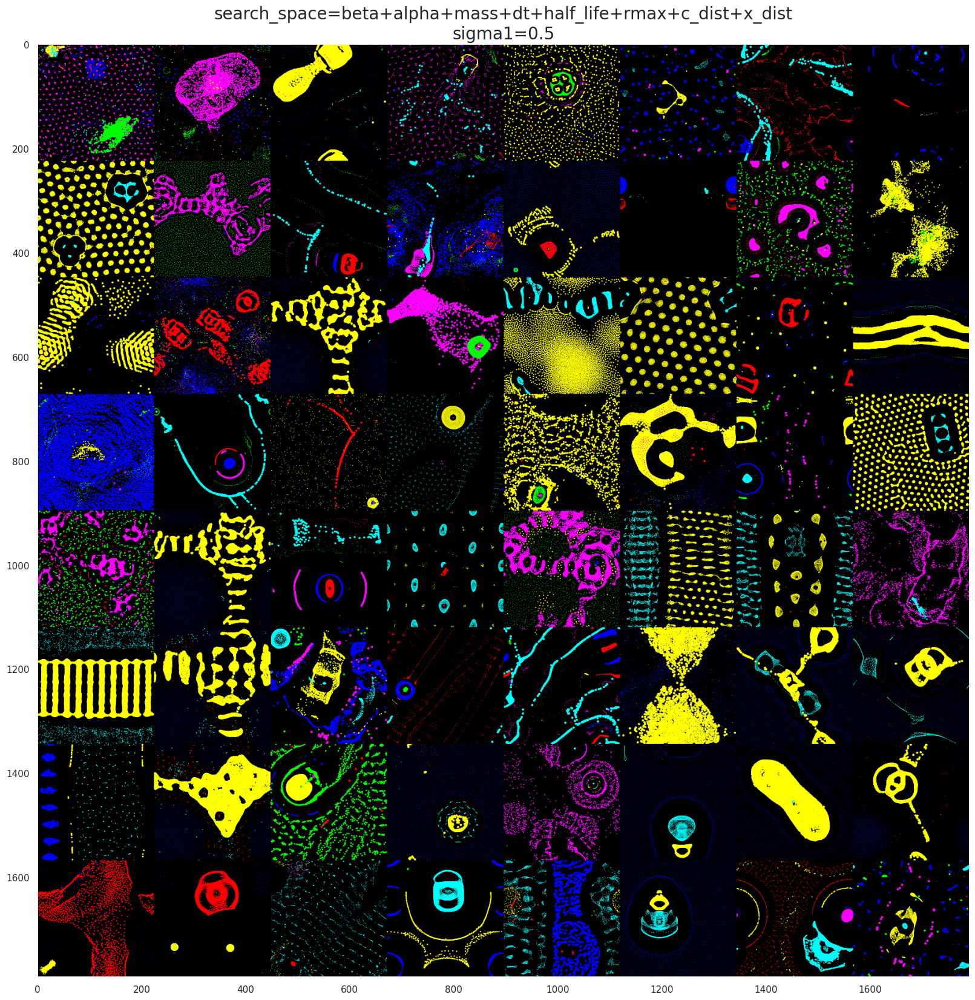

In [33]:
for cfg in cfgs:
    print(cfg)
    pop = util.load_pkl(cfg['save_dir'], 'pop')
    img = pop['img_final'].astype(np.uint8)[:64]
    print(img.shape)
    img = rearrange(img, "(R C) H W D -> (R H) (C W) D", R=8)
    print(img.shape)
    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.grid(False)
    plt.title(f"search_space={cfg['search_space']}\nsigma1={cfg['sigma1']}", fontsize=20)
    plt.show()

In [81]:
z = pop['z_img_final']
z.shape

(512, 512)

In [65]:
(z@z.T).shape

(512, 512)

In [164]:
from models_plife import ParticleLife
from jax.random import split

In [216]:
sim = ParticleLife(n_particles=5000, n_colors=6, search_space="alpha+beta", render_radius=7e-3)

In [217]:
@jax.jit
def get_img(rng, params):
    def step(state, _rng):
        next_state = sim.step_state(_rng, state, params)
        return next_state, state
    state_init = sim.init_state(rng, params)
    state_final, state_vid = jax.lax.scan(step, state_init, split(rng, int(1024)))
    return sim.render_state(state_final, params=params, img_size=256)

  0%|          | 0/40 [00:00<?, ?it/s]

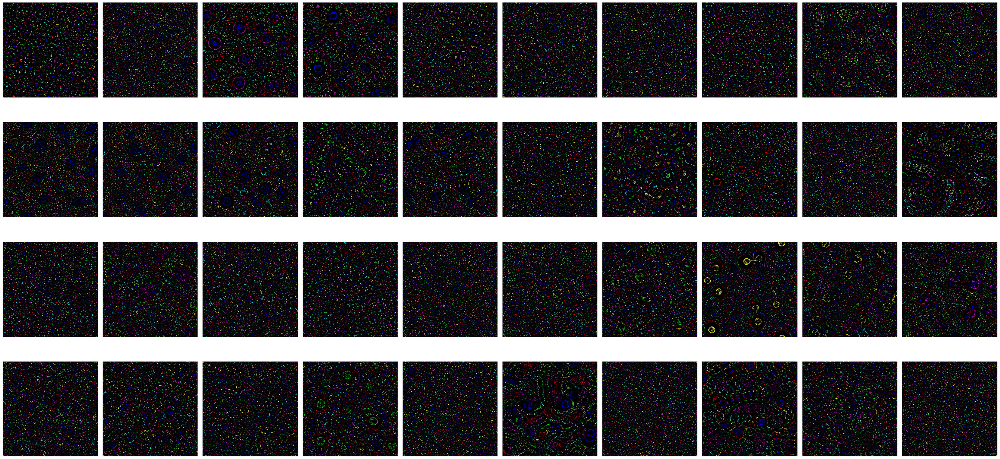

In [220]:
plt.figure(figsize=(40, 20))
for i in tqdm(range(40)):
    rng = jax.random.PRNGKey(i)
    params = sim.default_params(rng)
    params['beta'] = params['beta']+2.

    plt.subplot(4, 10, i+1)
    img = get_img(rng, params)
    plt.imshow(img)
    plt.grid(False); plt.xticks([]); plt.yticks([])

plt.tight_layout()
plt.show()